<H1><B> Bike Sharing Analysis</B></H1>

<h2><u>Introduction/Business Problem </u></h2>

Your mythical town board has asked you to help advise them on the feasibility establishing a bicycle ride sharing program in your community. They have received proposals from two vendors, and believe it would be wise public policy to offer such a program to help alleviate air pollution in the area. However, they wish to get a sense of how an existing program operates in another city of similar size, and what lessons might be learned to help decide if this should be a go-no go program.

<B>Among the questions for which the town board wishes information:</B>

- Is ridership widespread or concentrated in certain areas?
- Are most trips within a small radius or far-ranging?
- Are there any interesting demographic keys associated with ridership?
- For how long do riders rent their bikes?
- How prevalent is bike theft in the city?

This report intends to answer these questions by analyzing information from such a program in Toronto, Canada. Toronto is of similar size and of a similar climate and has had an active program for several years.

<h2><u>Data</u></h2> 

### Primary Sources


<a href=https://open.toronto.ca/dataset/bike-share-toronto-ridership-data>2018 Bike Share Ridership Statistics</a> Toronto's link to each of the 1.8 million trips taken in 2018. It also links to prior years, but only 2018 is used in this analysis.  <font size="-2"> Source:  City of Toronto Open Data Portal</font>
    
<a href=https://open.toronto.ca/dataset/neighbourhoods>Toronto Neighbourhood Geodata</a> Mapping data showing the boundaries of all Toronto neighborhoods.  <font size="-2"> Source: City of Toronto Open Data Portal</font>

<a href=http://data.torontopolice.on.ca/datasets/bicycle-thefts>Toronto Bicycle Thefts</a> Bicycle thefts in Toronto during 2018. Analysis will assist in assessing risk of bike share bikes being vulnerable.<font size="-2"> Source: Bicycle Thefts, Toronto Police Service, Public Safety Data Portal</font>

<a href=https://github.com/reddemon61/Coursera_Capstone/blob/master/loc_meta.csv>Geocoded list of Bike Share stations in Toronto</a> Lats and Longs were not readily available for the 270 bike share stations in Toronto proper, so this dataset was built by the author using Google Map's service. Geopy.geocoders Nominatim was tried for this, but it was not working properly with the long list of station names. <font size="-2"> Source: City of Toronto Open Data Portal</font>

<a href=https://open.toronto.ca/dataset/neighbourhood-profiles>Toronto Neighbourhood Profiles</a> Demographic data for the official Toronto Neighborhoods.  Data includes population, income and other data of lesser interest for this project. <font size="-2"> Source: City of Toronto Open Data Portal</font>

<a href=http://map.toronto.ca/wellbeing/#eyJ0b3Itd2lkZ2V0LWNsYXNzYnJlYWsiOsSAcGVyY2VudE9wYWNpdHnElzcwfSwiY3VzxIJtYcSTYcSXxIBuZWlnaGJvdXJob29kc8S2fcSrxIHEg8SFxIfEicSLdGFixYXEmCLEo3RpdmVUxZBJZMSXxYnEhMWPYi1vxZhyxI55xYXFiGFnc01hcMS2InrFgm3ElzExxKx4xJctODgzNjQ0NS4wMzc5ODk0xKzEpzo1NDIyMMaILjQ3NDDGkjHFiGluZGljYcSCcsWSxIDFpXNpb27ElzLErMaobmdsZcWxxK5yxJPEn1RpbWXFnMSoxKzFlsa7xqUiN8Wxxp3Gn8ahxqPFnHNBxp5XxLnEu3TFklvEgMSHxZ43MyLErHfHj2h0xbbErMSTxqdlUG%2FEjnLEpcaNZmFsc2XEq8eUxZ06IjE1MMeZIsebxLrHncefIsehxJvHrcekx6bHqMSXx6rHrMeuLMewxZ4zx5jHmsecx546xbjHvWXHosiBxLPIgzrIhcetx68ix5XHsjE0yIzHuMiOx7zHvsakx6PHpciWxKbIhMeryJrIiMicx7HHszM4x7fHuceQyKTIk8e%2FyKfIgsiqyJjIrMiHyInInjLHt8ilyIDIqMenyLzImceuXcWHxYjHgGXHrcenyY%2FFhsSsxrXGt3RJxp7GoMaixINNxYPGs8eyxq%2FGscazxYc%3D> WellBeing Toronto</a> Population, Income, Education and Crime data by Neighbourhood. <font size="-2"> Source: City of Toronto</font>



### Media Stories


<a href=https://www.cbc.ca/news/canada/toronto/despite-losses-city-set-to-pump-more-money-into-bike-share-1.4560453>Despite losses, city set to pump more money into Bike Share</a> 
<font size="-2">Source:  Michael Smee · CBC News  Posted: Mar 03, 2018 4:00 AM ET</font>

<a href=https://www.thestar.com/news/city_hall/2019/02/28/bike-share-toronto-gets-75-million-expansion-despite-operating-losses.html>Bike Share Toronto gets \$7.5-million expansion despite operating losses</a> 
<font size="-2">Source: The Star, By Jennifer Pagliaro City Hall Bureau, Feb. 28, 2019</font>

<a href=https://urbantoronto.ca/news/2019/03/bike-share-2019-expansion-105-more-stations-1250-new-bikes> Bike Share 2019 Expansion 105 More Stations, 1,250 New Bikes</a> <font size="-2">Source: Urban Toronto, Ryan Deberge, Mar. 01, 2019</font>

### Websites

<a href=https://bikesharetoronto.com>Bike Share Toronto</a> 


<h2><u>Methodology</u></h2>

In [317]:
import requests 
import pandas as pd 
import numpy as np 
import random 
import time
import sklearn
import geopandas as gpd
from sklearn.cluster import KMeans
import seaborn as sns; sns.set()
import csv
import matplotlib.pyplot as plt 
import folium
import geopy
from IPython.display import Image
from geopy.geocoders import Nominatim

In [294]:
final=pd.read_csv('FullData.csv')
clustered_data=pd.read_csv('clustered_data.csv')

<h3>Are most trips within a smaller radius or far-ranging?</h3>

To get a better idea of riding habits it was decided to break up trips into certain geographic areas, and then evaluate how many trips took place in one zone as opposed to crossing one or more additional zones. To identify these zones, a K-Means Clustering methodology was used. The process and the results are shown below

<h5><c><u>K-Means Clustering</u></c></h5>

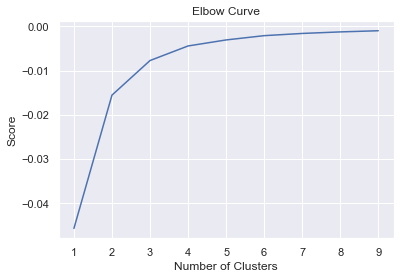

In [260]:
df = pd.read_csv('loc_meta.csv')

df = df.head(10000)
df.shape
df.dropna(axis=0,how='any',subset=['lats','longs'],inplace=True)

# Variable with the Longitude and Latitude
X=df.loc[:,['station_name','lats','longs']]
X.head(10)

K_clusters = range(1,10)
kmeans = [KMeans(n_clusters=i) 

for i in K_clusters]
Y_axis = df[['lats']]
X_axis = df[['longs']]
score = [kmeans[i].fit(Y_axis).score(Y_axis)

for i in range(len(kmeans))] 
plt.plot(K_clusters, score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.show()

In [261]:
kmeans = KMeans(n_clusters = 3, init ='k-means++')
kmeans.fit(X[X.columns[1:3]]) 

X['cluster_label'] = kmeans.fit_predict(X[X.columns[1:3]])
centers = kmeans.cluster_centers_ # Coordinates of cluster centers.
labels = kmeans.predict(X[X.columns[1:3]]) # Labels of each pointX.head(10)

X.head(5)

X = X[['station_name','cluster_label']]
X.head(5)

clustered_data = df.merge(X, left_on='station_name', right_on='station_name')
clustered_data.head(5)
clustered_data.to_csv('clustered_data.csv')
centers = kmeans.cluster_centers_


In [262]:
def color(cluster_label): 
    if cluster_label == 0: 
        col = 'red'
    elif cluster_label == 1: 
        col = 'blue'
    elif cluster_label == 2: 
        col = 'green'
    else: 
        col='orange'
    return col 

# create map
map_clusters = folium.Map(location=[43.6534817, -79.3839347], zoom_start=11)

for lats, longs, station_name, cluster_label in zip(clustered_data['lats'], clustered_data['longs'], clustered_data['station_name'],clustered_data['cluster_label']):
    label = '{}'.format(station_name)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lats, longs],
        radius=2,
        popup=label,
        color=color(cluster_label),
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.3,
        parse_html=False).add_to(map_clusters) 
       
map_clusters

Cluster 0 is in the center of town. Cluster 1 is to the left and Cluster 2 is to the right.

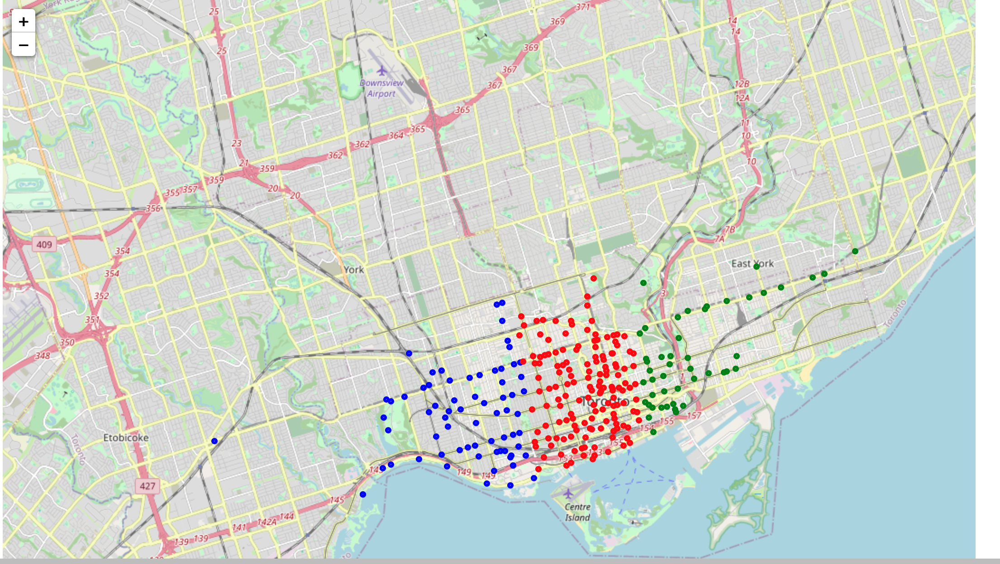

In [319]:
Image(filename="cluster1.png")#Shown in the event map doesn't render

#### K-Means Clustering allows for the creation and use of trip zones to help understand the nature of the ridership, as the following will show.

In [289]:
tofromzone=final.groupby(['to_cluster_label','from_cluster_label']).size()


In [290]:
tofromzone

to_cluster_label  from_cluster_label
0                 0                     1022538
                  1                      153748
                  2                      102139
1                 0                      157826
                  1                      103604
                  2                       13515
2                 0                      105774
                  1                       14380
                  2                       43512
dtype: int64

As can be seen, over a million trips both originated and ended within Cluster 0.

<h3>Is ridership widespread or concentrated in certain areas?</h3>

The previous section looked at trips within and between cluster areas. This section will focus more on which point-to-point trips were more and less popular.

In [330]:
fromto=final.groupby(['from_station_name','to_station_name']).size()

In [331]:
fromto.sort_values(ascending=False)

from_station_name                              to_station_name                        
Bay St / Queens Quay W (Ferry Terminal)        Bay St / Queens Quay W (Ferry Terminal)    3697
Humber Bay Shores Park West                    Humber Bay Shores Park West                2232
Bathurst St/Queens Quay(Billy Bishop Airport)  York St / Queens Quay W                    2034
Front St W / Blue Jays Way                     Union Station                              1997
York St / Queens Quay W                        York St / Queens Quay W                    1997
                                                                                          ... 
Mortimer Ave / Coxwell Ave                     King St W / Spadina Ave                       1
King St E / Jarvis St                          Kendal Ave / Spadina Rd                       1
Wright / Sorauren (Sorauren Park) - SMART      Queen St E / Sackville St                     1
Mortimer Ave / Coxwell Ave                     King St E /

<h3>Are there any interesting demographic keys associated with ridership?</h3>

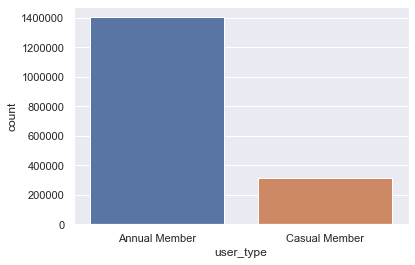

In [299]:
sns.countplot(x=final.user_type)

In [267]:
hood_geo=gpd.read_file('Neighbourhoods.geojson')
hood_demo=pd.read_csv('wellbeing_toronto-3.csv')
del hood_demo['Combined Indicators']
hood_demo[["Neighbourhood Id", "Total Population", "Average Family Income", "Assaults", "Rented Dwellings", "With Bachelor Degree or Higher"]] = hood_demo[["Neighbourhood Id", "Total Population", "Average Family Income", "Assaults", "Rented Dwellings", "With Bachelor Degree or Higher"]].astype(int)
#hood_geo['Hood'] = hood_geo['AREA_NAME'].str.split('(').str[0]
hood_demo.head(2)

,Neighbourhood,Neighbourhood Id,Total Population,Average Family Income,Assaults,Rented Dwellings,With Bachelor Degree or Higher,Total Area
0,West Humber-Clairville,1,33312,72820,259,3050,6170,30.09
1,Mount Olive-Silverstone-Jamestown,2,32954,57411,213,5070,4450,4.60


In [297]:
import folium
import pandas as pd

hood_geo = r'Neighbourhoods.geojson'
hood_pop = r'TorDemo.csv'

hood_data = pd.read_csv(hood_pop)
map_clusters = folium.Map(location=[43.6534817, -79.3839347], zoom_start=11)

folium.Choropleth(
    geo_data=hood_geo,
    name='choropleth',
    data=hood_data,
    columns = ['Neighbourhood Id','Total Population'],
    key_on='feature.properties.AREA_SHORT_CODE',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.7,
    legend_name='Population by Neighbourhood -- 2016',
).add_to(map_clusters)

for lats, longs, station_name, cluster_label in zip(clustered_data['lats'], clustered_data['longs'], clustered_data['station_name'],clustered_data['cluster_label']):
    label = '{}'.format(station_name)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lats, longs],
        radius=2,
        popup=label,
        color=color(cluster_label),
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_clusters) 

folium.LayerControl().add_to(map_clusters)

map_clusters


#### Station overlay of a 2016 population by neighbourhood choropleth

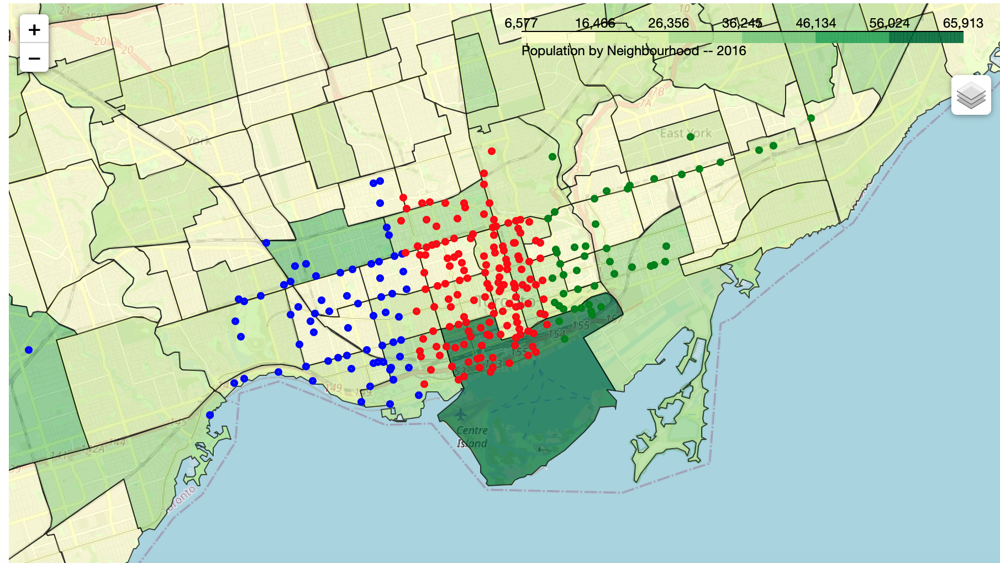

In [329]:
Image(filename="cluster2.png")#Shown in the event map doesn't render

In [333]:
import folium
import pandas as pd

hood_geo = r'Neighbourhoods.geojson'
hood_pop = r'TorDemo.csv'

hood_data = pd.read_csv(hood_pop)
map_clusters = folium.Map(location=[43.6534817, -79.3839347], zoom_start=11)

folium.Choropleth(
    geo_data=hood_geo,
    name='choropleth',
    data=hood_data,
    columns = ['Neighbourhood Id','Average Family Income'],
    key_on='feature.properties.AREA_SHORT_CODE',
    fill_color='YlGn',
    fill_opacity=0.8,
    line_opacity=0.8,
    legend_name='Income by Neighbourhood -- 2016',
).add_to(map_clusters)

for lats, longs, station_name, cluster_label in zip(clustered_data['lats'], clustered_data['longs'], clustered_data['station_name'],clustered_data['cluster_label']):
    label = '{}'.format(station_name)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lats, longs],
        radius=2,
        popup=label,
        color=color(cluster_label),
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_clusters) 

folium.LayerControl().add_to(map_clusters)

map_clusters



#### Station overlay of an income by neighbourhood choropleth

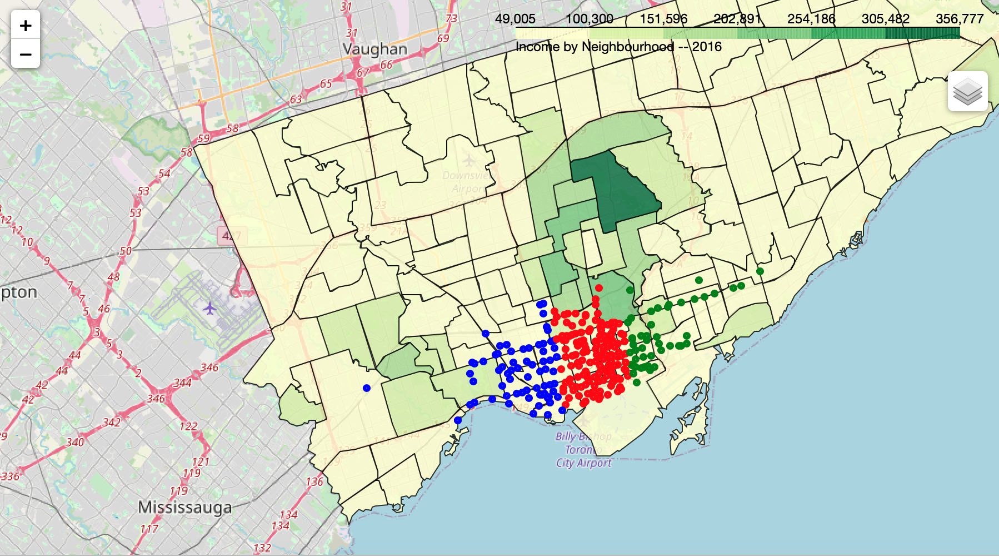

In [328]:
Image(filename="cluster3.png")#Shown in the event map doesn't render

In [296]:
import folium
import pandas as pd

hood_geo = r'Neighbourhoods.geojson'
hood_pop = r'TorDemo.csv'

hood_data = pd.read_csv(hood_pop)
map_clusters = folium.Map(location=[43.6534817, -79.3839347], zoom_start=11)

folium.Choropleth(
    geo_data=hood_geo,
    name='choropleth',
    data=hood_data,
    columns = ['Neighbourhood Id','With Bachelor Degree or Higher'],
    key_on='feature.properties.AREA_SHORT_CODE',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.7,
    legend_name='With Bachelor Degree or Higher by Neighbourhood -- 2016',
).add_to(map_clusters)

for lats, longs, station_name, cluster_label in zip(clustered_data['lats'], clustered_data['longs'], clustered_data['station_name'],clustered_data['cluster_label']):
    label = '{}'.format(station_name)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lats, longs],
        radius=2,
        popup=label,
        color=color(cluster_label),
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_clusters) 

folium.LayerControl().add_to(map_clusters)

map_clusters




#### An overlay of bike stations over a choropleth showing college graduates by neighbourhood

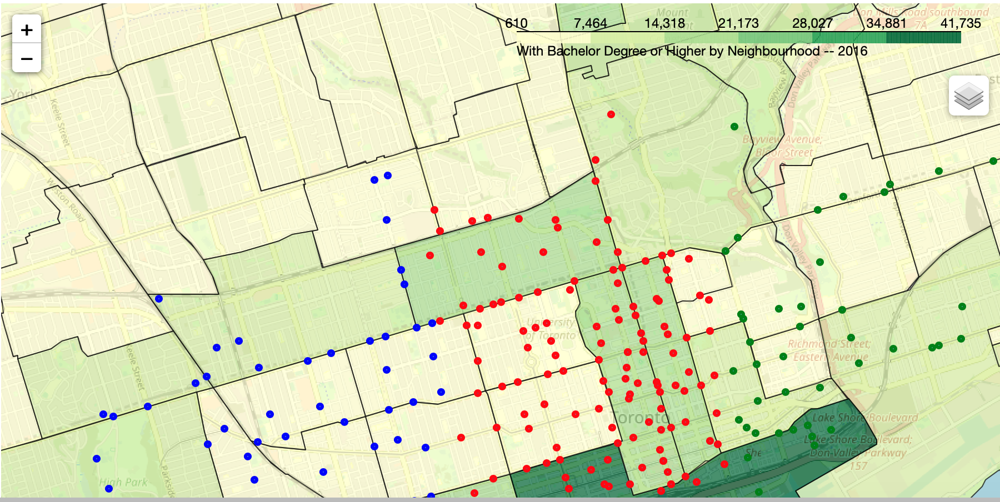

In [327]:
Image(filename="cluster4.png")#Shown in the event map doesn't render

<h3>For how long do riders rent their bikes?</h3>

In [300]:
aggregation = {
    'Popular Destinations': pd.NamedAgg(column='to_station_name', aggfunc='size'),
    'Trip Length': pd.NamedAgg(column='trip_duration_seconds', aggfunc=('sum','mean'))
}
z=final.groupby('to_station_name').agg(**aggregation)

In [301]:
z=final.groupby('to_station_name').agg(**aggregation)

In [302]:
n=z.sort_values('Popular Destinations', ascending=False)

In [303]:
n['Minutes'] = n['Trip Length'] / 60

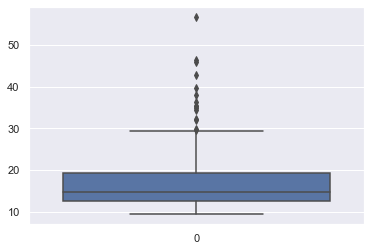

In [304]:
sns.boxplot(data=n.Minutes) 

<h3>How prevalent is bike theft in the city?</h3>

In [307]:
TPS = gpd.read_file('TPS_Toronto_Bicycle_Thefts.geojson')

In [308]:
TPS = TPS.loc[TPS['Occurrence_Year'] == 2018]

In [309]:

hood_geo = r'Neighbourhoods.geojson'
hood_pop = r'TorDemo.csv'

hood_data = pd.read_csv(hood_pop)
map_TPS = folium.Map(location=[43.6534817, -79.3839347], zoom_start=11)

folium.Choropleth(
    geo_data=hood_geo,
    name='choropleth',
    data=hood_data,
    columns = ['Neighbourhood Id','Assaults'],
    key_on='feature.properties.AREA_SHORT_CODE',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.7,
    legend_name='Assaults by Neighbourhood -- 2016',
).add_to(map_TPS)

for Lat, Long, Neighbourhood , in zip(TPS['Lat'], TPS['Long'], TPS['Neighbourhood']):
    label = '{}'.format(Neighbourhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [Lat, Long],
        radius=2,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_TPS)  
    
map_TPS

<h4>Bicycle thefts in 2018 on a choropleth showing assaults by neighbourhood.</h4>

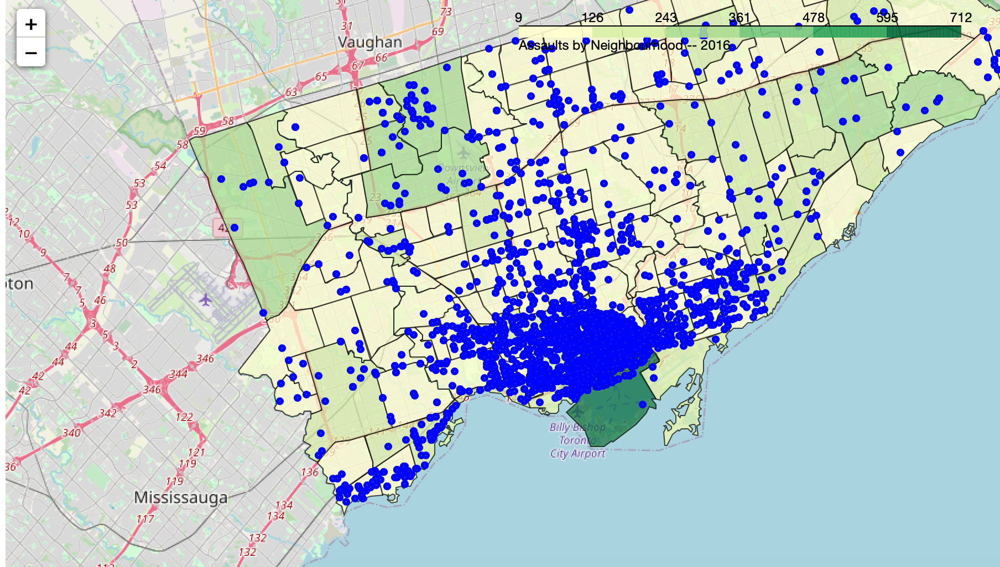

In [326]:
Image(filename="cluster5.png")#Shown in the event map doesn't render

<h2><u>Results</u></h2> 

Results will be in the accompanying report and presentation

<h2><u>Discussion</u></h2>

Discussion will be in the accompanying report and presentation

<h2><u>Conclusion</u></h2>

Conclusions will be in the accompanying report and presentation